import 시작

In [1]:
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import randint
from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import make_scorer, accuracy_score, recall_score, precision_score, f1_score, confusion_matrix, classification_report


from dataloader import load_data

In [2]:
pd.set_option('display.max_columns', None)

df = load_data(help = True)
df

    
        load_data함수는 원본 데이터를 가져와 다음과 같이 전처리한다

        1. 하나의 이상치를 제거한다
        2. sparse한 Target 컬럼 7개를 제거하고 하나의 특성(Type)으로 만든다 
        3. Area 특성을 만들고 다음 4개의 특성(X_Maximum, X_Minimum, Y_Maximum, Y_Minimum)을 제거한다
        4. A300을 0, A400을 1로 하는 TypeOfSteel 특성을 생성하고 A300, A400은 제거한다
        5. Log_X_index, Log_Y_index를 제거한다 -> Log_X_index만 제거한다, Log_Y_Index는 정규분포라 이후 Log를 취할 필요가 없다
        6. Outside_Global_Index를 제거한다 -> Outside_Global_Index를 제거하지 않는다
              
        원본 데이터 기준 1940개의 행과 23개의 열(22개의 특성 + 1개의 타겟: Type)을 갖는다
        


,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Type,Area
0,267,17,44,24220,76,108,1687,0,80,0.0498,0.2415,0.1818,0.0047,0.4706,1.0000,1.0,2.4265,1.6435,0.8182,-0.2913,0.5822,Pastry,352
1,108,10,30,11397,84,123,1687,0,80,0.7647,0.3793,0.2069,0.0036,0.6000,0.9667,1.0,2.0334,1.4624,0.7931,-0.1756,0.2984,Pastry,174
2,71,8,19,7972,99,125,1623,0,100,0.9710,0.3426,0.3333,0.0037,0.7500,0.9474,1.0,1.8513,1.2553,0.6667,-0.1228,0.2150,Pastry,108
3,176,13,45,18996,99,126,1353,1,290,0.7287,0.4413,0.1556,0.0052,0.5385,1.0000,1.0,2.2455,1.6532,0.8444,-0.1568,0.5212,Pastry,315
4,2409,60,260,246930,37,126,1353,1,185,0.0695,0.4486,0.0662,0.0126,0.2833,0.9885,1.0,3.3818,2.4099,0.9338,-0.1992,1.0000,Pastry,4369
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1935,273,54,22,35033,119,141,1360,1,40,0.3662,0.3906,0.5714,0.0206,0.5185,0.7273,0.0,2.4362,1.2041,-0.4286,0.0026,0.7254,Other_Faults,448
1936,287,44,24,34599,112,133,1360,1,40,0.2118,0.4554,0.5484,0.0228,0.7046,0.7083,0.0,2.4579,1.2305,-0.4516,-0.0582,0.8173,Other_Faults,527
1937,292,40,22,37572,120,140,1360,1,40,0.2132,0.3287,0.5172,0.0213,0.7250,0.6818,0.0,2.4654,1.1761,-0.4828,0.0052,0.7079,Other_Faults,435
1938,419,97,47,52715,117,140,1360,1,40,0.2015,0.5904,0.9394,0.0243,0.3402,0.6596,0.0,2.6222,1.4914,-0.0606,-0.0171,0.9919,Other_Faults,1023


In [3]:
df.value_counts('Type')

Type
Other_Faults    673
Bumps           402
K_Scatch        390
Z_Scratch       190
Pastry          158
Stains           72
Dirtiness        55
dtype: int64

In [4]:
df.describe()

,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Area
count,1940.000000,1940.000000,1940.000000,1.940000e+03,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000
mean,1816.166495,106.526804,73.652062,2.004435e+05,84.592268,130.180412,1459.223711,0.599485,78.757732,0.331872,0.413930,0.571057,0.033320,0.610836,0.813376,0.575515,2.491001,1.401799,0.082819,-0.131163,0.585207,4064.463402
std,3872.819439,188.775659,116.249962,4.423759e+05,32.085131,18.686619,144.588037,0.490129,55.093208,0.299710,0.136769,0.270827,0.058949,0.242963,0.234296,0.482380,0.786762,0.449810,0.500572,0.148674,0.339409,11364.096187
min,2.000000,2.000000,1.000000,2.500000e+02,0.000000,37.000000,1227.000000,0.000000,40.000000,0.000000,0.000000,0.009000,0.001500,0.064500,0.048400,0.000000,0.301000,0.000000,-0.991000,-0.998900,0.119000,2.000000
25%,84.000000,15.000000,13.000000,9.519500e+03,63.000000,124.000000,1358.000000,0.000000,40.000000,0.060400,0.315775,0.361525,0.006600,0.411800,0.596675,0.000000,1.924300,1.079200,-0.333300,-0.194850,0.247875,135.750000
50%,173.500000,26.000000,25.000000,1.919550e+04,90.000000,127.000000,1364.000000,1.000000,70.000000,0.227550,0.412050,0.556800,0.010100,0.636400,0.947400,1.000000,2.239300,1.322200,0.094900,-0.132900,0.506300,306.000000
75%,814.500000,84.000000,83.000000,8.267650e+04,106.000000,140.000000,1650.000000,1.000000,80.000000,0.574650,0.501300,0.818200,0.023425,0.800000,1.000000,1.000000,2.910925,1.732400,0.502900,-0.066575,0.999800,1604.000000
max,37334.000000,1275.000000,903.000000,3.918209e+06,203.000000,253.000000,1794.000000,1.000000,300.000000,0.995200,0.927500,1.000000,0.875900,1.000000,1.000000,1.000000,4.572100,2.776000,0.960700,0.642100,1.000000,168084.000000


In [5]:
def plot_distribution(df):
    num_plots = len(df.columns)
    num_cols = 6
    num_rows = num_plots // num_cols if num_plots % num_cols == 0 else num_plots // num_cols + 1

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(num_cols*4, num_rows*4))

    for i, col in enumerate(df.columns):
        row = i // num_cols
        pos = i % num_cols
        sns.histplot(df[col], kde=True, ax=axs[row][pos])
        axs[row][pos].set_title(f'{col}')

    plt.tight_layout()
    plt.show()

In [6]:
# Feature들의 분포를 보고 싶다면 주석 지우고 실행
# plot_distribution(df)

df_log는 상단 features에 log 취한 데이터이다

In [7]:
# 정규분포를 위한 log 변환
log_list = ['X_Perimeter',
            'Y_Perimeter',
            'Steel_Plate_Thickness',
            # 'Edges_Index', # <- 0이 들어있어서 로그변환이 안됨 zerodivision_error
            'Outside_X_Index',
            'Area',
            'Edges_Y_Index',
            'Pixels_Areas',
            'Sum_of_Luminosity']

df_log = df.copy()

for i in log_list:
    df_log[i] = np.log(df[i])

In [8]:
# log 변환 된 features의 분포를 보고 싶다면 주석 지우고 실행
# plot_distribution(df_log)

이중분류를 위한 전처리 진행

In [9]:
# 0이면 Other_Faults
df_bin = df_log.copy()
df_bin['Type'] = df_bin['Type'].apply(lambda x: 1 if x != 'Other_Faults' else 0)
df_bin['Type'].value_counts(normalize=True)

1    0.653093
0    0.346907
Name: Type, dtype: float64

df_bin은 df_log를 이진분류하기위해 Type을 전처리한 것이다

다중분류를 위한 전처리 진행 - Other_Faults 행 제거

In [10]:
df_log.value_counts('Type')

Type
Other_Faults    673
Bumps           402
K_Scatch        390
Z_Scratch       190
Pastry          158
Stains           72
Dirtiness        55
dtype: int64

In [11]:
# Other_Faults 제거
Other_Faults_idx = df_log[df_log['Type'] == 'Other_Faults'].index

df_multi = df_log.copy()
df_multi = df_multi.drop(Other_Faults_idx)
df_multi.value_counts('Type')

Type
Bumps        402
K_Scatch     390
Z_Scratch    190
Pastry       158
Stains        72
Dirtiness     55
dtype: int64

df_multi는 df_log에서 기타 결함인 행을 뺀 데이터다

다중분류 시작

언샘플링, StandardScaler()

In [12]:
target = 'Type'

x = df_multi.drop(columns=target)
y = df_multi[target]

encoder = LabelEncoder()
y= encoder.fit_transform(y) 


x_train, x_test, y_train, y_test = train_test_split(
    x, y, test_size = 0.2, stratify=y, random_state=42)

scaler = StandardScaler()
x_train = pd.DataFrame(scaler.fit_transform(x_train), columns=x.columns)
x_test = pd.DataFrame(scaler.transform(x_test), columns=x.columns)
print(encoder.classes_)

print('업샘플링하지 않고 StandardScaler만 적용한 데이터입니다.')
print('x_train: ', x_train.shape, 'x_test: ', x_test.shape, 'y_train: ', y_train.shape, 'y_test: ', y_test.shape)

['Bumps' 'Dirtiness' 'K_Scatch' 'Pastry' 'Stains' 'Z_Scratch']
업샘플링하지 않고 StandardScaler만 적용한 데이터입니다.
x_train:  (1013, 22) x_test:  (254, 22) y_train:  (1013,) y_test:  (254,)


In [13]:
rf_multi_model = RandomForestClassifier(random_state=42,
                                   class_weight='balanced',
                                   n_jobs=-1)

param_grid = {
    'n_estimators': randint(200, 500),
    'max_depth': randint(10, 30),
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(2, 10),
    'max_features': randint(2, 20),
    'bootstrap': [True, False] 
    }

rf_random_v0 = RandomizedSearchCV(
    rf_multi_model, param_distributions=param_grid, n_iter=1000, cv=5, scoring='f1_weighted', verbose=2)

rf_random_v0.fit(x_train, y_train)

print("최적의 하이퍼파라미터: ", rf_random_v0.best_params_)
print("최고 f1_score: ", rf_random_v0.best_score_)


Fitting 5 folds for each of 1000 candidates, totalling 5000 fits


[CV] END bootstrap=True, max_depth=22, max_features=4, min_samples_leaf=5, min_samples_split=5, n_estimators=356; total time=   2.7s
[CV] END bootstrap=True, max_depth=22, max_features=4, min_samples_leaf=5, min_samples_split=5, n_estimators=356; total time=   0.1s
[CV] END bootstrap=True, max_depth=22, max_features=4, min_samples_leaf=5, min_samples_split=5, n_estimators=356; total time=   0.1s
[CV] END bootstrap=True, max_depth=22, max_features=4, min_samples_leaf=5, min_samples_split=5, n_estimators=356; total time=   0.1s
[CV] END bootstrap=True, max_depth=22, max_features=4, min_samples_leaf=5, min_samples_split=5, n_estimators=356; total time=   0.1s
[CV] END bootstrap=False, max_depth=29, max_features=3, min_samples_leaf=6, min_samples_split=3, n_estimators=275; total time=   0.1s
[CV] END bootstrap=False, max_depth=29, max_features=3, min_samples_leaf=6, min_samples_split=3, n_estimators=275; total time=   0.1s
[CV] END bootstrap=False, max_depth=29, max_features=3, min_samples

In [14]:
param_best = {'bootstrap': True, 
              'max_depth': 14, 
              'max_features': 7, 
              'min_samples_leaf': 2, 
              'min_samples_split': 3, 
              'n_estimators': 402
              }

rf_best_random_v0 = RandomForestClassifier(**param_best)

rf_best_random_v0.fit(x_train, y_train)
y_pred = rf_best_random_v0.predict(x_test)

print("테스트 정확도: ", accuracy_score(y_test, y_pred))
print("테스트 recall: ", recall_score(y_test, y_pred, average='weighted'))
print("테스트 Precision: ", precision_score(y_test, y_pred, average='weighted'))
print("테스트 F1-score: ", f1_score(y_test, y_pred, average='weighted'))
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_pred, y_test))

테스트 정확도:  0.9094488188976378
테스트 recall:  0.9094488188976378
테스트 Precision:  0.9118950560464647
테스트 F1-score:  0.9091169344045686
              precision    recall  f1-score   support

           0       0.88      0.90      0.89        81
           1       0.67      0.91      0.77        11
           2       0.97      0.97      0.97        78
           3       0.81      0.69      0.75        32
           4       1.00      1.00      1.00        14
           5       0.97      0.95      0.96        38

    accuracy                           0.91       254
   macro avg       0.88      0.90      0.89       254
weighted avg       0.91      0.91      0.91       254

[[73  1  2  6  0  1]
 [ 3 10  0  2  0  0]
 [ 0  0 76  1  0  1]
 [ 5  0  0 22  0  0]
 [ 0  0  0  0 14  0]
 [ 0  0  0  1  0 36]]


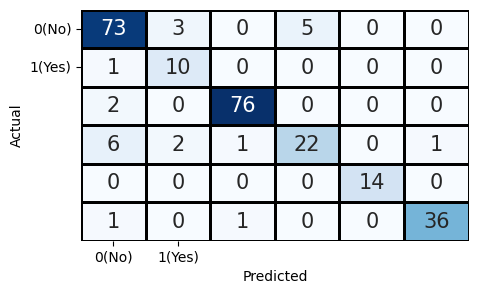

In [15]:
plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

업샘플링, StandardScaler

In [16]:
from imblearn.over_sampling import ADASYN

target = 'Type'

x = df_multi.drop(columns=target)
y = df_multi[target]

encoder = LabelEncoder()
y= encoder.fit_transform(y) 
print(encoder.classes_)

x_train, x_test, y_train, y_test = train_test_split(
    x, y, test_size = 0.2, stratify=y, random_state=42)

adasyn = ADASYN(random_state=42)
x_train, y_train = adasyn.fit_resample(x_train, y_train)

scaler = StandardScaler()
x_train = pd.DataFrame(scaler.fit_transform(x_train), columns=x.columns)
x_test = pd.DataFrame(scaler.transform(x_test), columns=x.columns)

print('업샘플링 후 StandardScaler 적용한 데이터입니다.')
print('x_train: ', x_train.shape, 'x_test: ', x_test.shape, 'y_train: ', y_train.shape, 'y_test: ', y_test.shape)
print(np.unique(y, return_counts=True))

['Bumps' 'Dirtiness' 'K_Scatch' 'Pastry' 'Stains' 'Z_Scratch']
업샘플링 후 StandardScaler 적용한 데이터입니다.
x_train:  (1932, 22) x_test:  (254, 22) y_train:  (1932,) y_test:  (254,)
(array([0, 1, 2, 3, 4, 5]), array([402,  55, 390, 158,  72, 190], dtype=int64))


In [17]:
rf_multi_model = RandomForestClassifier(random_state=42,
                                   class_weight='balanced',
                                   n_jobs=-1)

param_grid = {
    'n_estimators': randint(200, 500),
    'max_depth': randint(10, 30),
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(2, 10),
    'max_features': randint(2, 20),
    'bootstrap': [True, False]
    }

rf_random_v1 = RandomizedSearchCV(
    rf_multi_model, param_distributions=param_grid, n_iter=1000, cv=5, scoring='f1_weighted', verbose=2)

rf_random_v1.fit(x_train, y_train)

print("최적의 하이퍼파라미터: ", rf_random_v1.best_params_)
print("최고 f1_score: ", rf_random_v1.best_score_)


Fitting 5 folds for each of 1000 candidates, totalling 5000 fits
[CV] END bootstrap=False, max_depth=19, max_features=9, min_samples_leaf=4, min_samples_split=9, n_estimators=461; total time=   0.3s
[CV] END bootstrap=False, max_depth=19, max_features=9, min_samples_leaf=4, min_samples_split=9, n_estimators=461; total time=   0.4s
[CV] END bootstrap=False, max_depth=19, max_features=9, min_samples_leaf=4, min_samples_split=9, n_estimators=461; total time=   0.3s
[CV] END bootstrap=False, max_depth=19, max_features=9, min_samples_leaf=4, min_samples_split=9, n_estimators=461; total time=   0.4s
[CV] END bootstrap=False, max_depth=19, max_features=9, min_samples_leaf=4, min_samples_split=9, n_estimators=461; total time=   0.3s
[CV] END bootstrap=False, max_depth=28, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=428; total time=   0.3s
[CV] END bootstrap=False, max_depth=28, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=428; total time=   0.

In [18]:
from sklearn.metrics import make_scorer, accuracy_score, recall_score, precision_score, f1_score, confusion_matrix, classification_report


y_pred = rf_random_v1.predict(x_test)

print("테스트 정확도: ", accuracy_score(y_test, y_pred))
print("테스트 recall: ", recall_score(y_test, y_pred, average='weighted'))
print("테스트 Precision: ", precision_score(y_test, y_pred, average='weighted'))
print("테스트 F1-score: ", f1_score(y_test, y_pred, average='weighted'))
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_pred, y_test))

테스트 정확도:  0.8937007874015748
테스트 recall:  0.8937007874015748
테스트 Precision:  0.8983724772602726
테스트 F1-score:  0.8944073332349628
              precision    recall  f1-score   support

           0       0.87      0.83      0.85        81
           1       0.69      1.00      0.81        11
           2       1.00      0.96      0.98        78
           3       0.75      0.75      0.75        32
           4       0.93      1.00      0.97        14
           5       0.92      0.95      0.94        38

    accuracy                           0.89       254
   macro avg       0.86      0.91      0.88       254
weighted avg       0.90      0.89      0.89       254

[[67  0  3  6  0  1]
 [ 4 11  0  1  0  0]
 [ 0  0 75  0  0  0]
 [ 7  0  0 24  0  1]
 [ 1  0  0  0 14  0]
 [ 2  0  0  1  0 36]]


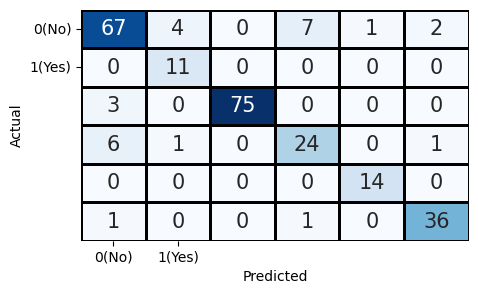

In [19]:
plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

업샘플링, XGBoost, StandardScaler

In [20]:
from imblearn.over_sampling import ADASYN

target = 'Type'

x = df_multi.drop(columns=target)
y = df_multi[target]

encoder = LabelEncoder()
y= encoder.fit_transform(y) 
print(encoder.classes_)


x_train, x_test, y_train, y_test = train_test_split(
    x, y, test_size = 0.2, stratify=y, random_state=42)

adasyn = ADASYN(random_state=42)
x_train, y_train = adasyn.fit_resample(x_train, y_train)

scaler = StandardScaler()
x_train = pd.DataFrame(scaler.fit_transform(x_train), columns=x.columns)
x_test = pd.DataFrame(scaler.transform(x_test), columns=x.columns)

print('업샘플링 후 StandardScaler 적용한 데이터입니다.')
print('x_train: ', x_train.shape, 'x_test: ', x_test.shape, 'y_train: ', y_train.shape, 'y_test: ', y_test.shape)
print(np.unique(y, return_counts=True))

['Bumps' 'Dirtiness' 'K_Scatch' 'Pastry' 'Stains' 'Z_Scratch']
업샘플링 후 StandardScaler 적용한 데이터입니다.
x_train:  (1932, 22) x_test:  (254, 22) y_train:  (1932,) y_test:  (254,)
(array([0, 1, 2, 3, 4, 5]), array([402,  55, 390, 158,  72, 190], dtype=int64))


In [21]:
from scipy.stats import randint, uniform
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from xgboost import XGBClassifier

xgb_model = XGBClassifier(random_state=42, n_estimator = 1000)

param_dist = {
    'eta': uniform(0.01, 0.3),
    'max_depth': randint(3, 10),
    'min_child_weight': randint(1, 3),
    'gamma': uniform(0.1, 0.3),
    'subsample': uniform(0.5, 0.9),
}

# 랜덤 서치 수행
xgb_random_v0 = RandomizedSearchCV(
    xgb_model, param_distributions=param_dist, n_iter=10000, cv=5, scoring='f1_weighted', verbose=2)

# 학습 데이터에 랜덤 서치 수행
xgb_random_v0.fit(x_train, y_train)

# 최적의 하이퍼파라미터와 평가 지표 출력
print("최적의 하이퍼파라미터: ", xgb_random_v0.best_params_)
print("최고 f1_score: ", xgb_random_v0.best_score_)

Fitting 5 folds for each of 10000 candidates, totalling 50000 fits
[CV] END eta=0.13848757439616466, gamma=0.32140167814664306, max_depth=8, min_child_weight=2, subsample=1.225016986199398; total time=   0.0s
[CV] END eta=0.13848757439616466, gamma=0.32140167814664306, max_depth=8, min_child_weight=2, subsample=1.225016986199398; total time=   0.0s
[CV] END eta=0.13848757439616466, gamma=0.32140167814664306, max_depth=8, min_child_weight=2, subsample=1.225016986199398; total time=   0.0s
[CV] END eta=0.13848757439616466, gamma=0.32140167814664306, max_depth=8, min_child_weight=2, subsample=1.225016986199398; total time=   0.0s
[CV] END eta=0.13848757439616466, gamma=0.32140167814664306, max_depth=8, min_child_weight=2, subsample=1.225016986199398; total time=   0.0s
[CV] END eta=0.16128670332369396, gamma=0.23445579600518912, max_depth=4, min_child_weight=1, subsample=1.144759319075083; total time=   0.0s
[CV] END eta=0.16128670332369396, gamma=0.23445579600518912, max_depth=4, min_chi

c:\Users\born9\anaconda3\envs\Abal\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
22570 fits failed out of a total of 50000.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
10 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\born9\anaconda3\envs\Abal\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\born9\anaconda3\envs\Abal\lib\site-packages\xgboost\core.py", line 620, in inner_f
    return func(**kwargs)
  File "c:\Users\born9\anaconda3\envs\Abal\lib\site-packages\xgboost\sklearn.py", line 1490, in fit
    self._Booster = train(
  File "c:\Users\born9\anaconda

[04:42:19] WARNING: C:\Users\dev-admin\croot2\xgboost-split_1675461376218\work\src\learner.cc:767: 
Parameters: { "n_estimator" } are not used.

최적의 하이퍼파라미터:  {'eta': 0.21654661384797788, 'gamma': 0.16577372866147214, 'max_depth': 5, 'min_child_weight': 1, 'subsample': 0.5697302198093128}
최고 f1_score:  0.9518046656508057


In [22]:
from sklearn.metrics import make_scorer, accuracy_score, recall_score, precision_score, f1_score, confusion_matrix, classification_report


y_pred = xgb_random_v0.predict(x_test)

print("테스트 정확도: ", accuracy_score(y_test, y_pred))
print("테스트 recall: ", recall_score(y_test, y_pred, average='weighted'))
print("테스트 Precision: ", precision_score(y_test, y_pred, average='weighted'))
print("테스트 F1-score: ", f1_score(y_test, y_pred, average='weighted'))
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_pred, y_test))

테스트 정확도:  0.9133858267716536
테스트 recall:  0.9133858267716536
테스트 Precision:  0.917634304424607
테스트 F1-score:  0.9143782079412734
              precision    recall  f1-score   support

           0       0.91      0.85      0.88        81
           1       0.79      1.00      0.88        11
           2       1.00      0.99      0.99        78
           3       0.71      0.78      0.75        32
           4       0.93      1.00      0.97        14
           5       0.97      0.95      0.96        38

    accuracy                           0.91       254
   macro avg       0.89      0.93      0.90       254
weighted avg       0.92      0.91      0.91       254

[[69  0  1  6  0  0]
 [ 3 11  0  0  0  0]
 [ 0  0 77  0  0  0]
 [ 8  0  0 25  0  2]
 [ 1  0  0  0 14  0]
 [ 0  0  0  1  0 36]]


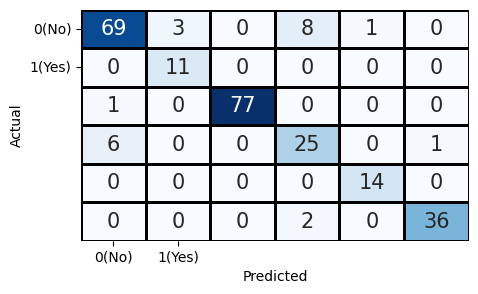

In [23]:
plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()